## Overview

This script performs EDA and then preprocesses multiple datasets to train a BERT which is in turn used to predict the sentiments behind tweets fetched in real time using `tweepy` and classify them as positive negative or neutral.

The model is then integrated with streamlit and deployed as a web-app.

## Installing and importing dependencies

To fetch tweets from twitter, we need to install the tweepy library. We will be using this package to pull tweets on which our model will make predictions.

In [ ]:
!pip install opendatasets
!pip install twint
!pip install nest_asyncio
!pip install joblib

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing
import os
import tweepy as tw #for accessing Twitter API
import opendatasets as od
import nest_asyncio
import twint#for accessing Twitter Data
nest_asyncio.apply()

#For Preprocessing
import re    # RegEx for removing non-letter characters
import nltk  #natural language processing
nltk.download("stopwords")
from nltk.corpus import stopwords
from nltk.stem.porter import *

# For Building the model
from sklearn.model_selection import train_test_split
import tensorflow as tf
import seaborn as sns

#For data visualization
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from joblib import dump, load
import joblib
%matplotlib inline

pd.options.plotting.backend = "plotly"

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
akvnr71# # od.download("https://www.kaggle.com/datasets/kazanova/sentiment140")
od.download("https://www.kaggle.com/datasets/tariqsays/sentiment-dataset-with-1-million-tweets")
od.download("https://www.kaggle.com/datasets/yasserh/twitter-tweets-sentiment-dataset")
# od.download("https://www.kaggle.com/datasets/cosmos98/twitter-and-reddit-sentimental-analysis-dataset")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: akvnr71
Your Kaggle Key: ··········


100%|██████████| 75.4M/75.4M [00:01<00:00, 66.4MB/s]



Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: akvnr71
Your Kaggle Key: ··········


100%|██████████| 1.23M/1.23M [00:00<00:00, 61.6MB/s]

## Exploratory Data Analysis

### Cleaning and prepping dataset

In [ ]:
# # Load Tweet dataset
# df1 = pd.read_csv('/content/input/sentiment140/training.1600000.processed.noemoticon.csv', encoding='latin-1', names=['target', 'ids', 'date', 'flag', 'user', 'text'])
# # Drop unnecessary columns
# df1 = df1.drop(columns=['ids', 'date', 'flag', 'user'])
# # Rename target column to match existing dataset
# df1['target'] = df1['target'].map({0: -1.0, 2: 0.0, 4: 1.0})
# # Rename text column to match existing dataset
# df1 = df1.rename(columns={'target': 'category', 'text': 'clean_text'})
# df1 = df1[['clean_text', 'category']]
# # Output first five rows
# df1.head()

In [ ]:
# Load Tweet dataset
df2 = pd.read_csv('/content/sentiment-dataset-with-1-million-tweets/dataset.csv')
df2 = df2.drop(columns=['Language'])
df2 = df2.rename(columns={'Text': 'clean_text', 'Label': 'category'})
df2['category'] = df2['category'].map({
    'negative': -1.0,
    'neutral': 0.0,
    'positive': 1.0,
    'litigious': -1.0,
    'uncertainty': 0.0
})
# Output first five rows

df2.head()

,clean_text,category
0,@Charlie_Corley @Kristine1G @amyklobuchar @Sty...,-1.0
1,#BadBunny: Como dos gotas de agua: Joven se di...,-1.0
2,https://t.co/YJNiO0p1JV Flagstar Bank disclose...,-1.0
3,Rwanda is set to host the headquarters of Unit...,1.0
4,OOPS. I typed her name incorrectly (today’s br...,-1.0


The `category` column has 3 values:
1. 0 Indicating it is a Neutral Sentiment
2. 1 Indicating a Postive Sentiment
3. -1 Indicating a Negative Sentiment

In [ ]:
# Load Tweet dataset
df3 = pd.read_csv('/content/twitter-tweets-sentiment-dataset/Tweets.csv')
print(df3.columns)
df3 = df3.drop(columns=['selected_text', 'textID'])
df3 = df3.rename(columns={'text': 'clean_text', 'sentiment':'category'})
df3['category'] = df3['category'].map({'neutral': 0.0, 'negative': -1.0, 'positive':1.0})
# Output first five rows
df3.head()


Index(['textID', 'text', 'selected_text', 'sentiment'], dtype='object')


,clean_text,category
0,"I`d have responded, if I were going",0.0
1,Sooo SAD I will miss you here in San Diego!!!,-1.0
2,my boss is bullying me...,-1.0
3,what interview! leave me alone,-1.0
4,"Sons of ****, why couldn`t they put them on t...",-1.0


In [ ]:
df = pd.concat([df2,df3], ignore_index=True)

In [ ]:
# Check for missing data
df.isnull().sum()

clean_text    1
category      0
dtype: int64

In [ ]:
# drop missing rows
df.dropna(axis=0, inplace=True)

In [ ]:
# dimensionality of the data
df.shape

(965334, 2)

In [ ]:
# Map tweet categories
df['category'] = df['category'].map({-1.0:'Negative', 0.0:'Neutral', 1.0:'Positive'})

# Output first five rows
df.head()

,clean_text,category
0,@Charlie_Corley @Kristine1G @amyklobuchar @Sty...,Negative
1,#BadBunny: Como dos gotas de agua: Joven se di...,Negative
2,https://t.co/YJNiO0p1JV Flagstar Bank disclose...,Negative
3,Rwanda is set to host the headquarters of Unit...,Positive
4,OOPS. I typed her name incorrectly (today’s br...,Negative


## Exploratory Data Analysis

Data Visualisation-

In [ ]:
# The distribution of sentiments
df.groupby('category').count().plot(kind='bar')

Plotting the distribution of tweet lengths

In [ ]:
# Calculate tweet lengths
tweet_len = pd.Series([len(tweet.split()) for tweet in df['clean_text']])

# The distribution of tweet text lengths
tweet_len.plot(kind='box')

Plotting the distribution of text length for positive sentiment tweets

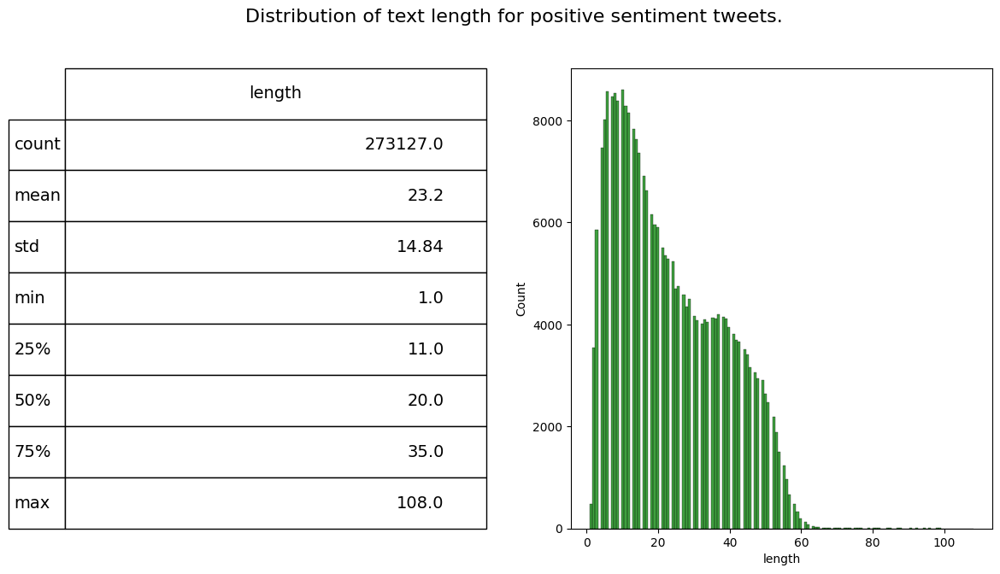

In [ ]:
fig = plt.figure(figsize=(14,7))
df['length'] = df.clean_text.str.split().apply(len)
ax1 = fig.add_subplot(122)
sns.histplot(df[df['category']=='Positive']['length'], ax=ax1,color='green')
describe = df.length[df.category=='Positive'].describe().to_frame().round(2)

ax2 = fig.add_subplot(121)
ax2.axis('off')
font_size = 14
bbox = [0, 0, 1, 1]
table = ax2.table(cellText = describe.values, rowLabels = describe.index, bbox=bbox, colLabels=describe.columns)
table.set_fontsize(font_size)
fig.suptitle('Distribution of text length for positive sentiment tweets.', fontsize=16)

plt.show()

Plotting the Distribution of text length for Negative sentiment tweets.

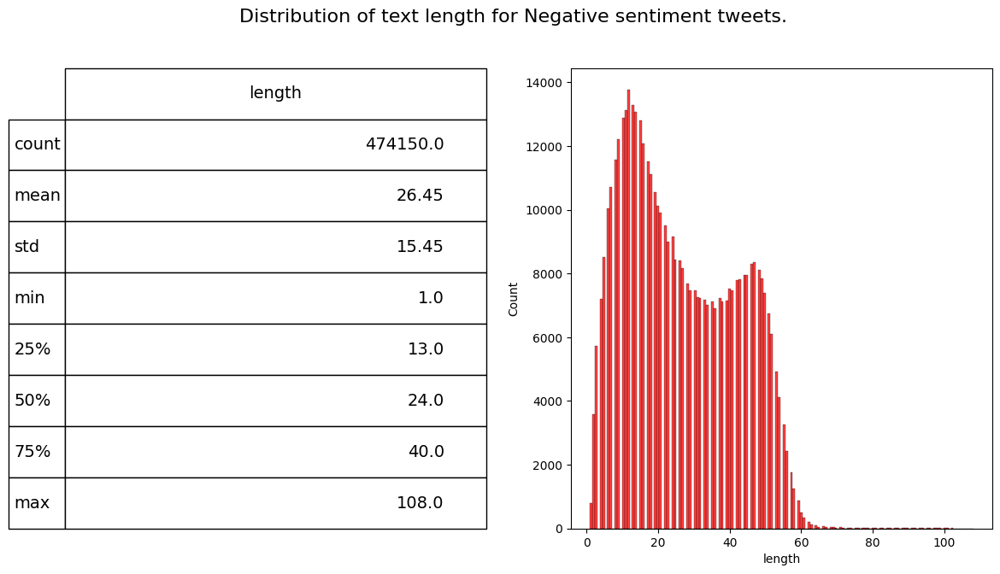

In [ ]:
fig = plt.figure(figsize=(14,7))
df['length'] = df.clean_text.str.split().apply(len)
ax1 = fig.add_subplot(122)
sns.histplot(df[df['category']=='Negative']['length'], ax=ax1,color='red')
describe = df.length[df.category=='Negative'].describe().to_frame().round(2)

ax2 = fig.add_subplot(121)
ax2.axis('off')
font_size = 14
bbox = [0, 0, 1, 1]
table = ax2.table(cellText = describe.values, rowLabels = describe.index, bbox=bbox, colLabels=describe.columns)
table.set_fontsize(font_size)
fig.suptitle('Distribution of text length for Negative sentiment tweets.', fontsize=16)

plt.show()

Plotting the Pie chart of the percentage of different sentiments of all the tweets

In [ ]:
import plotly.express as px
fig = px.pie(df, names='category', title ='Pie chart of different sentiments of tweets')
fig.show()

In [ ]:
df.drop(['length'], axis=1, inplace=True)
df.head

<bound method NDFrame.head of                                                clean_text  category
0       @Charlie_Corley @Kristine1G @amyklobuchar @Sty...  Negative
1       #BadBunny: Como dos gotas de agua: Joven se di...  Negative
2       https://t.co/YJNiO0p1JV Flagstar Bank disclose...  Negative
3       Rwanda is set to host the headquarters of Unit...  Positive
4       OOPS. I typed her name incorrectly (today’s br...  Negative
...                                                   ...       ...
965330   wish we could come see u on Denver  husband l...  Negative
965331   I`ve wondered about rake to.  The client has ...  Negative
965332   Yay good for both of you. Enjoy the break - y...  Positive
965333                         But it was worth it  ****.  Positive
965334     All this flirting going on - The ATG smiles...   Neutral

[965334 rows x 2 columns]>

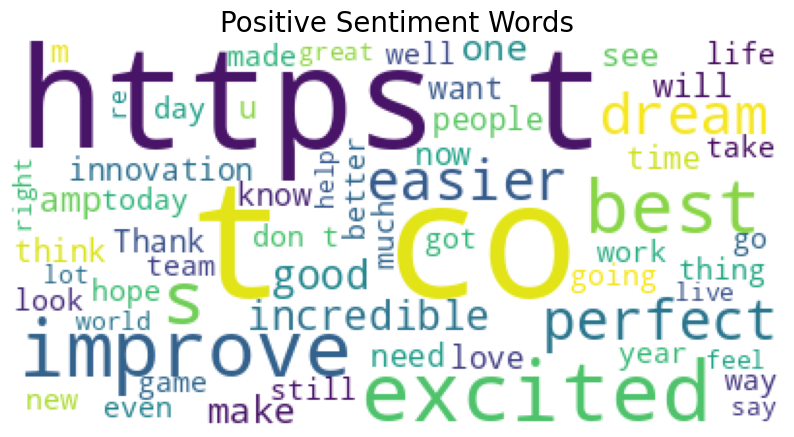

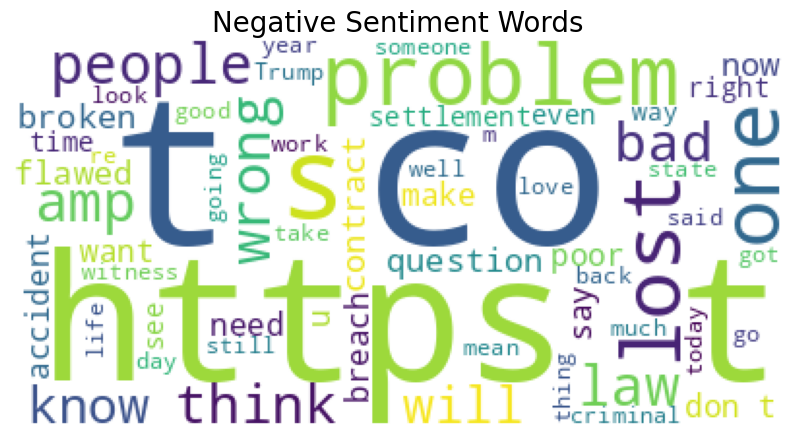

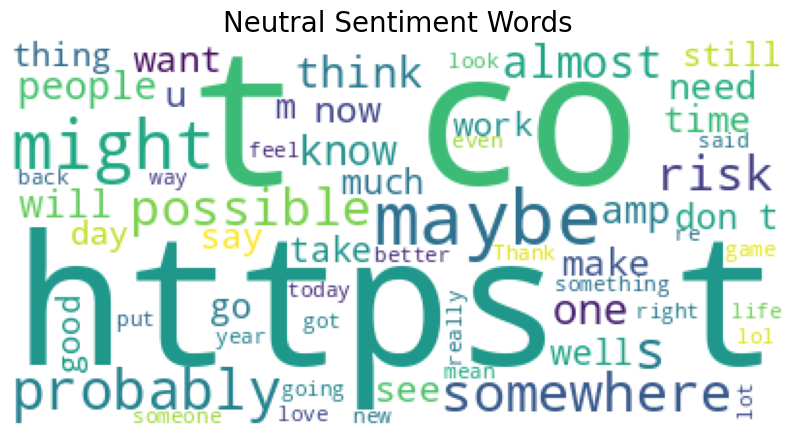

In [ ]:
#### Visualizing data into wordclouds


from wordcloud import WordCloud, STOPWORDS

def wordcount_gen(df, category):
    '''
    Generating Word Cloud
    inputs:
       - df: tweets dataset
       - category: Positive/Negative/Neutral
    '''
    # Combine all tweets
    combined_tweets = " ".join([tweet for tweet in df[df.category==category]['clean_text']])

    # Initialize wordcloud object
    wc = WordCloud(background_color='white',
                   max_words=60,
                   stopwords = STOPWORDS)

    # Generate and plot wordcloud
    plt.figure(figsize=(10,10))
    plt.imshow(wc.generate(combined_tweets))
    plt.title('{} Sentiment Words'.format(category), fontsize=20)
    plt.axis('off')
    plt.show()
    print("\n\n")

# Positive tweet words
wordcount_gen(df, 'Positive')

# Negative tweet words
wordcount_gen(df, 'Negative')

# Neutral tweet words
wordcount_gen(df, 'Neutral')



## Data Preprocessing

In [ ]:
def tweet_to_words(tweet):
    ''' Convert tweet text into a sequence of words '''

    # convert to lowercase
    text = tweet.lower()
    # remove non letters
    text = re.sub(r"[^a-zA-Z0-9]", " ", text)
    # tokenize
    words = text.split()
    # remove stopwords
    words = [w for w in words if w not in stopwords.words("english")]
    # apply stemming
    words = [PorterStemmer().stem(w) for w in words]
    # return list
    return words

print("\nOriginal tweet ->", df['clean_text'][0])
print("\nProcessed tweet ->", tweet_to_words(df['clean_text'][0]))


Original tweet -> @Charlie_Corley @Kristine1G @amyklobuchar @StyleWriterNYC testimony is NOT evidence in a court of law, state or federal. Must stand up to cross examination

Processed tweet -> ['charli', 'corley', 'kristine1g', 'amyklobuchar', 'stylewriternyc', 'testimoni', 'evid', 'court', 'law', 'state', 'feder', 'must', 'stand', 'cross', 'examin']


In [ ]:
# Apply data processing to each tweet
X = list(map(tweet_to_words, df['clean_text']))

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Encode target labels
le = LabelEncoder()
Y = le.fit_transform(df['category'])
data = pd.DataFrame({'clean_text': X, 'category': Y})
data.to_csv('preprocessed_data.csv', index=False)
preprocessed_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/XY_data.csv')
X = preprocessed_data['clean_text']
Y = preprocessed_data['category']

In [ ]:
print(X[0])
print(Y[0])

['charli', 'corley', 'kristine1g', 'amyklobuchar', 'stylewriternyc', 'testimoni', 'evid', 'court', 'law', 'state', 'feder', 'must', 'stand', 'cross', 'examin']
0


### Train and test split

In [ ]:
y = pd.get_dummies(df['category'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1)

### Bag of words (BOW) feature extraction

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
#from sklearn.feature_extraction.text import TfidfVectorizer

vocabulary_size = 5000

# Tweets have already been preprocessed hence dummy function will be passed in
# to preprocessor & tokenizer step
count_vector = CountVectorizer(max_features=vocabulary_size,
#                               ngram_range=(1,2),    # unigram and bigram
                                preprocessor=lambda x: x,
                               tokenizer=lambda x: x)
#tfidf_vector = TfidfVectorizer(lowercase=True, stop_words='english')

# Fit the training data
X_train = count_vector.fit_transform(X_train).toarray()

# Transform testing data
X_test = count_vector.transform(X_test).toarray()

In [ ]:
#import sklearn.preprocessing as pr

# Normalize BoW features in training and test set
#X_train = pr.normalize(X_train, axis=1)
#X_test  = pr.normalize(X_test, axis=1)

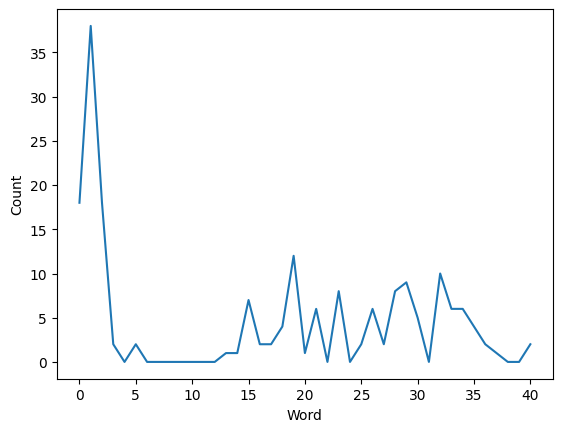

In [ ]:
# Plot the BoW feature vector
plt.plot(X_train[2,:])
plt.xlabel('Word')
plt.ylabel('Count')
plt.show()

### Tokenizing & Padding

In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

max_words = 5000
max_len=50

def tokenize_pad_sequences(text):
    '''
    This function tokenize the input text into sequnences of intergers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(num_words=max_words, lower=True, split=' ')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=max_len)
    # return sequences
    return X, tokenizer

print('Before Tokenization & Padding \n', df['clean_text'][0])
X, tokenizer = tokenize_pad_sequences(df['clean_text'])
print('After Tokenization & Padding \n', X[0])


Before Tokenization & Padding 
 @Charlie_Corley @Kristine1G @amyklobuchar @StyleWriterNYC testimony is NOT evidence in a court of law, state or federal. Must stand up to cross examination
After Tokenization & Padding 
 [3580  465    7   21  442   11    3  254    5   79  268   37  783  311
  752   58    2 1274 3760    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


In [ ]:
np.save('processed_data.npy', X)

### Saving tokenized data

In [ ]:
import pickle

# saving
with open('tokenizer.pickle', 'wb') as handle:
    pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

# loading
with open('tokenizer.pickle', 'rb') as handle:
    tokenizer = pickle.load(handle)

### Train & Test Split

In [ ]:
y = pd.get_dummies(df['category'])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=1)
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (579200, 50) (579200, 3)
Validation Set -> (193067, 50) (193067, 3)
Test Set -> (193067, 50) (193067, 3)


In [ ]:
import keras.backend as K

def f1_score(precision, recall):
    ''' Function to calculate f1 score '''

    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

## Bidirectional LSTM


In [ ]:
from keras.models import Sequential
from keras.layers import Embedding, Conv1D, MaxPooling1D, Bidirectional, LSTM, Dense, Dropout
from keras.metrics import Precision, Recall
from keras.optimizers import SGD
from keras.optimizers import RMSprop
from keras import datasets

from keras.callbacks import LearningRateScheduler
from keras.callbacks import History

from keras import losses

vocab_size = 5000
embedding_size = 32
epochs=20
learning_rate = 0.1
decay_rate = learning_rate / epochs
momentum = 0.8


sgd = SGD(learning_rate=learning_rate, momentum=momentum, nesterov=False)
# Build model
model= Sequential()
model.add(Embedding(vocab_size, embedding_size, input_length=max_len))
model.add(Conv1D(filters=32, kernel_size=3, padding='same', activation='relu'))
model.add(MaxPooling1D(pool_size=2))
model.add(Bidirectional(LSTM(32)))
model.add(Dropout(0.4))
model.add(Dense(3, activation='softmax'))

In [ ]:
import tensorflow as tf
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
print(model.summary())

# Compile model
model.compile(loss='categorical_crossentropy', optimizer=sgd,
               metrics=['accuracy', Precision(), Recall()])

# Train model

batch_size = 64
history = model.fit(X_train, y_train,
                      validation_data=(X_val, y_val),
                      batch_size=batch_size, epochs=epochs, verbose=1)

### Model Accuracy & Loss

In [ ]:
# Evaluate model on the test set
loss, accuracy, precision, recall = model.evaluate(X_test, y_test, verbose=0)
# Print metrics
print('')
print('Accuracy  : {:.4f}'.format(accuracy))
print('Precision : {:.4f}'.format(precision))
print('Recall    : {:.4f}'.format(recall))
print('F1 Score  : {:.4f}'.format(f1_score(precision, recall)))


Accuracy  : 0.9584
Precision : 0.9604
Recall    : 0.9570
F1 Score  : 0.9587


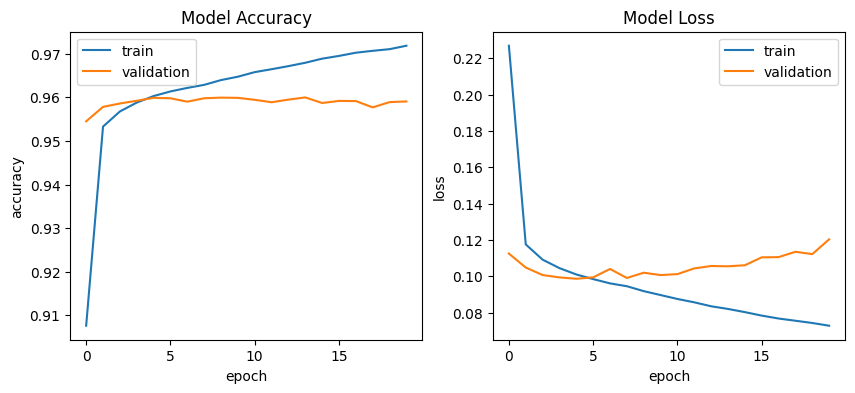

In [ ]:
def plot_training_hist(history):
    '''Function to plot history for accuracy and loss'''

    fig, ax = plt.subplots(1, 2, figsize=(10,4))
    # first plot
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_xlabel('epoch')
    ax[0].set_ylabel('accuracy')
    ax[0].legend(['train', 'validation'], loc='best')
    # second plot
    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_xlabel('epoch')
    ax[1].set_ylabel('loss')
    ax[1].legend(['train', 'validation'], loc='best')

plot_training_hist(history)

### Model Confusion Matrix

6034/6034 [==============================] - 44s 7ms/step


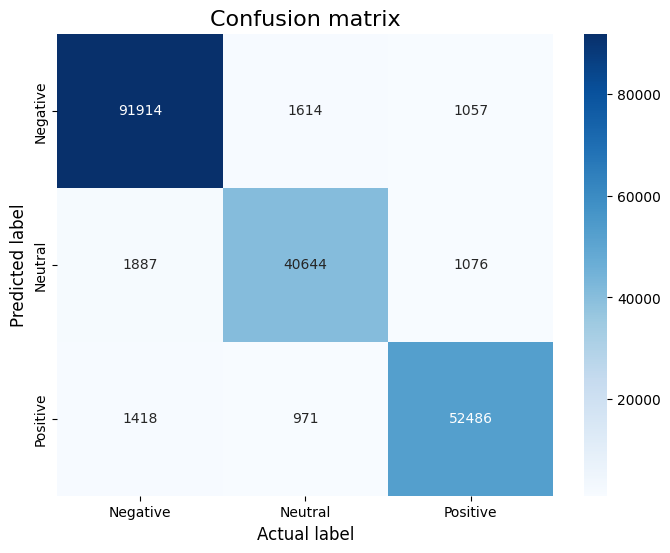

In [ ]:
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(model, X_test, y_test):
    '''Function to plot confusion matrix for the passed model and the data'''

    sentiment_classes = ['Negative', 'Neutral', 'Positive']
    # use model to do the prediction
    y_pred = model.predict(X_test)
    # compute confusion matrix
    cm = confusion_matrix(np.argmax(np.array(y_test),axis=1), np.argmax(y_pred, axis=1))
    # plot confusion matrix
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, cmap=plt.cm.Blues, annot=True, fmt='d',
                xticklabels=sentiment_classes,
                yticklabels=sentiment_classes)
    plt.title('Confusion matrix', fontsize=16)
    plt.xlabel('Actual label', fontsize=12)
    plt.ylabel('Predicted label', fontsize=12)

plot_confusion_matrix(model, X_test, y_test)

In [ ]:
# Save the model architecture & the weights
model.save('/content/drive/MyDrive/Colab Notebooks/best.h5')
model.save('best_2.h5')
print('Best model saved')

Best model saved


### Model save and load for the prediction

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import pickle
import numpy as np
def load_tokenizer_and_data():
    if os.path.exists('/content/drive/MyDrive/tokenizer.pickle') and os.path.exists('/content/drive/MyDrive/processed_data.npy'):
        # Load tokenizer
        with open('/content/drive/MyDrive/tokenizer.pickle', 'rb') as handle:
            tokenizer = pickle.load(handle)
        # Load processed data
        X = np.load('/content/drive/MyDrive/processed_data.npy')
        return tokenizer, X
    else:
        return None, None

In [ ]:
from keras.models import load_model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
tokenizer, X = load_tokenizer_and_data()
# Load model
model = load_model('/content/drive/MyDrive/Colab Notebooks/best_2.h5')

def predict_class(text):
    '''Function to predict sentiment class of the passed text'''

    sentiment_classes = ['Negative', 'Neutral', 'Positive']
    max_len=50

    # Transforms text to a sequence of integers using a tokenizer object
    xt = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    xt = pad_sequences(xt, padding='post', maxlen=max_len)
    # Do the prediction using the loaded model
    yt = model.predict(xt).argmax(axis=1)
    # Print the predicted sentiment
    print('The predicted sentiment is', sentiment_classes[yt[0]])

In [ ]:
additional_positive_texts = [
    "I'm so excited about the upcoming concert!",
    "The sunset was breathtakingly beautiful.",
    "My favorite team won the championship!",
    "I got accepted into my dream college!",
    "I finished reading a great book last night.",
    "The movie made me laugh so hard!",
    "I love this product!",
    "The weather is fantastic.",
    "He is a best minister india ever had seen",
    "this art is good",
    "After months of hard work and dedication, I finally achieved my goal of running a marathon, crossing the finish line with a sense of accomplishment and pride.",
    "The new park in our neighborhood is fantastic; it's a great place for families to spend time together.",
    "I feel incredibly lucky to have such wonderful coworkers who make coming to work a joy every day.",
    "Discovering a new favorite book is one of life's simple pleasures.",
    "I'm so proud of my sister for achieving her dream of becoming a doctor; her hard work and dedication paid off!"
]

additional_negative_texts = [
    "I hate Mondays.",
    "he is poor",
    "I'm feeling really down today.",
    "I missed my train and now I'm late for work.",
    "The weather ruined our picnic plans.",
    "I failed my driving test.",
    "I lost my wallet with all my money.",
    "My phone screen was broken.",
    "I got into an argument with my boss.",
    "I'm not feeling well, I think I'm coming down with something.",
    "My computer crashed and I lost all my work.",
    "This food tastes terrible.",
    "The service was awful.",
    "I hate when I have to call and wake people up",
    "The disappointment was palpable as I watched my team lose the championship game in the final minutes, the sting of defeat lingering long after the final whistle.",
    "The sad thing is, causing damage is slightly brighter under Trump.",
    "The ongoing conflict in the region has resulted in devastating consequences for the civilian population.",
    "I'm disappointed that the company decided to lay off so many employees without warning.",
    "The recent increase in crime rates is alarming and has left many residents feeling unsafe in their own neighborhoods.",
    "The loss of biodiversity in our ecosystems is a major cause for concern.",
    "I'm frustrated with the lack of progress on important social issues that affect marginalized communities.",
]

additional_neutral_texts = [
    "The new update didn't change much.",
    "I got a parking ticket this morning.",
    "I'm taking a walk in the park.",
    "I had cereal for breakfast.",
    "The song playing on the radio is alright.",
    "The sun was shining brightly as I walked through the park, feeling a sense of serenity and joy as I took in the beauty of nature around me.",
    "A lot of people are dismayed by starting art, but everyone starts somewhere.",
    "People always try to tell everyone starts somewhere.",
    "Starting art is always a thing, but everyone starts somewhere.",
    "I always try to tell everyone starts somewhere.",
    "We should all try starting art.",
    "I try to tell everyone starts somewhere.",
    "Everyone starts somewhere when it comes to art.",
    "Art starts somewhere, and that's okay.",
    "Everyone starts somewhere when it comes to art.",
    "Everyone who loves Star Trek, watches Star Trek, or helps create Star Trek might someday do so, and that's good.",
    "The threats to peace & environment are probably the most serious.",
    "They are heading for a fall, and probably into the hands of their acolytes - see #Ceausescu, #Qadafi, #Nero.",
    "Denmark is probably a better version.",
    "u are a good person, man. It seems almost fate that whoever’s life is protected, it's the right time for them. It could potentially be a life-changing moment for you. I respect you massively fr.",
]

# Test with additional positive texts
print("\nAdditional Positive Texts:")
for text in additional_positive_texts:
    # print(text)
    predict_class([text])

# Test with additional negative texts
print("\nAdditional Negative Texts:")
for text in additional_negative_texts:
    # print(text)
    predict_class([text])

print("\nAdditional Neutral Texts:")
for text in additional_neutral_texts:
    # print(text)
    predict_class([text])


Additional Positive Texts:
1/1 [==============================] - 1s 902ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 21ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 23ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 24ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 25ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 31ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 22ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 20ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 20ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 23ms/step
The predicted sentiment is Positive
1/1 [==============================] - 0s 25ms/step
The predicted sentiment is Positive
1/1